In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from matplotlib.lines import Line2D
from matplotlib.patches import Patch
import os, pickle
import magi_v2
from tqdm.notebook import tqdm
import tensorflow as tf

# load in our logs
insample_logs = pd.read_csv("logs/insample_logs.csv")
forecast_logs = pd.read_csv("logs/forecast_logs.csv")
physics_logs = pd.read_csv("logs/physics_logs.csv")

2024-12-26 23:34:55.534870: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2024-12-26 23:34:55.564682: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-12-26 23:34:55.568131: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:32] Could not find cuda drivers on your machine, GPU will not be used.
2024-12-26 23:34:55.577684: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:485] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-12-26 23:34:55.593247: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:8454] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been 

# Box-and-Whisker (In-Sample + Mechanistic Fidelity)


## 1. Parameter Estimation (Absolute Error)

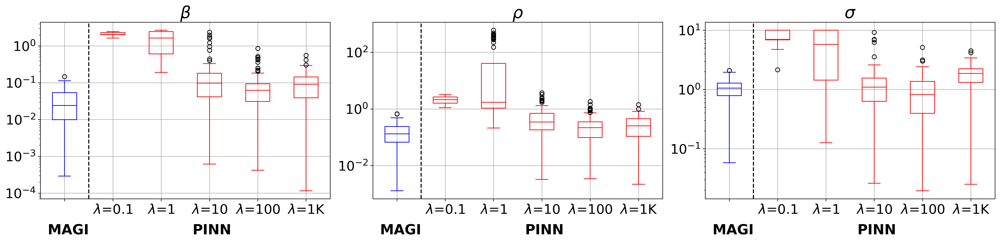

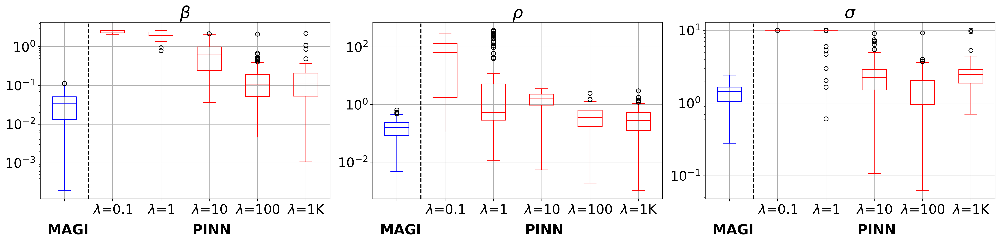

In [2]:
# hot-access letters
a, b, r, s = "a", "b", "r", "s"

# separate box plots for each regime + dobs (parameter inference)
for rho in [23.0, 28.0]:
    for dobs in [10]:
        for alpha in [0.05]:
        
            # restrict our query
            restricted = insample_logs.query(f"rho == {rho} and dobs == {dobs} and alpha == {alpha}")

            # 1 x 3 grid of subplots (beta, rho, sigma)
            fig, ax = plt.subplots(1, 3, dpi=300, figsize=(20, 5))
            
            # go thru each component
            for i, param in enumerate(["beta", "rho", "sigma"]):
                
                # grid it up
                ax[i].grid()
                
                # MAGI absolute errors (of posterior means)
                ax[i].boxplot(x=np.abs(restricted.query("model == 'magi'")[f"{param}hat_err"]), 
                              positions=[0], boxprops={"color" : "blue"}, whiskerprops={"color" : "blue"}, 
                              capprops={"color" : "blue"}, medianprops={"color" : "blue"}, widths=0.5)
                
                # go thru PINN
                for j, lmbda in enumerate([0.1, 1.0, 10.0, 100.0, 1000.0]):
                    ax[i].boxplot(x=np.abs(restricted.query(f"lmbda == {lmbda}")[f"{param}hat_err"]),
                                  positions=[j+1], boxprops={"color" : "red"}, whiskerprops={"color" : "red"}, 
                                  capprops={"color" : "red"}, medianprops={"color" : "red"}, widths=0.5)
                
                # beautify
                ax[i].set_title(f"$\{param}$", fontsize=24)
                ax[i].set_yscale("log")
                ax[i].set_xticklabels(["", 
                                       "$\lambda$=0.1", 
                                       "$\lambda$=1", 
                                       "$\lambda$=10", 
                                       "$\lambda$=100", 
                                       "$\lambda$=1K"])
                ax[i].tick_params("both", labelsize=19)
                ax[i].axvline(x=0.5, color="black", linestyle="--")
                ax[i].annotate("PINN", xy=(0.525, -0.2), 
                               xycoords="axes fraction", fontsize=20, weight="bold")
                ax[i].annotate("MAGI", xy=(0.025, -0.2), 
                               xycoords="axes fraction", fontsize=20, weight="bold")
            
            # overall beautifying
            regime_desc = "Lorenz (Stable, Transient Chaos)" if rho == 23.0 else "Lorenz (Chaotic, Butterfly)"
            plt.tight_layout()
            plt.savefig(f"camera_ready/boxplots/param-estim_rho={rho}_dobs={dobs}_alpha={alpha}.jpg", 
                        facecolor="white", bbox_inches="tight")
            plt.show()

## 2. Trajectory Reconstruction (RMSE)

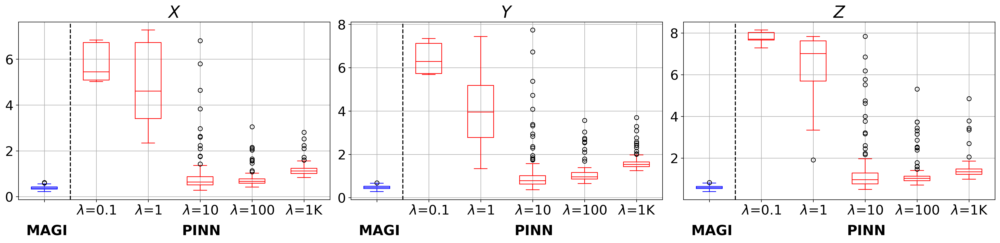

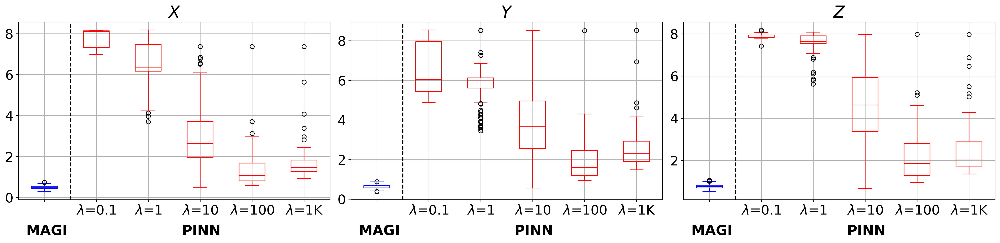

In [3]:
# hot-access letters
a, b, r, s = "a", "b", "r", "s"

# separate box plots for each regime + dobs (parameter inference)
for rho in [23.0, 28.0]:
    for dobs in [10]:
        for alpha in [0.05]:
        
            # restrict our query
            restricted = insample_logs.query(f"rho == {rho} and dobs == {dobs} and alpha == {alpha}")

            # 1 x 3 grid of subplots (beta, rho, sigma)
            fig, ax = plt.subplots(1, 3, dpi=300, figsize=(20, 5))
            
            # go thru each component
            for i, var in enumerate(["X", "Y", "Z"]):
                
                # grid it up
                ax[i].grid()
                
                # MAGI absolute errors (of posterior means)
                ax[i].boxplot(x=np.abs(restricted.query("model == 'magi'")[f"{var}_rmse"]), 
                              positions=[0], boxprops={"color" : "blue"}, whiskerprops={"color" : "blue"}, 
                              capprops={"color" : "blue"}, medianprops={"color" : "blue"}, widths=0.5)
                
                # go thru PINN
                for j, lmbda in enumerate([0.1, 1.0, 10.0, 100.0, 1000.0]):
                    ax[i].boxplot(x=np.abs(restricted.query(f"lmbda == {lmbda}")[f"{var}_rmse"]),
                                  positions=[j+1], boxprops={"color" : "red"}, whiskerprops={"color" : "red"}, 
                                  capprops={"color" : "red"}, medianprops={"color" : "red"}, widths=0.5)
                
                # beautify
                ax[i].set_title(f"${var}$", fontsize=24)
                ax[i].set_xticklabels(["", 
                                       "$\lambda$=0.1", 
                                       "$\lambda$=1", 
                                       "$\lambda$=10", 
                                       "$\lambda$=100", 
                                       "$\lambda$=1K"])
                ax[i].tick_params("both", labelsize=19)
                ax[i].axvline(x=0.5, color="black", linestyle="--")
                ax[i].annotate("PINN", xy=(0.525, -0.2), 
                               xycoords="axes fraction", fontsize=20, weight="bold")
                ax[i].annotate("MAGI", xy=(0.025, -0.2), 
                               xycoords="axes fraction", fontsize=20, weight="bold")
            
            # overall beautifying
            regime_desc = "Lorenz (Stable, Transient Chaos)" if rho == 23.0 else "Lorenz (Chaotic, Butterfly)"
            plt.tight_layout()
            plt.savefig(f"camera_ready/boxplots/traj-inf_rho={rho}_dobs={dobs}_alpha={alpha}.jpg", 
                        facecolor="white", bbox_inches="tight")
            plt.show()

## 3. Mechanistic Fidelity via pRMSE (Physics RMSE)

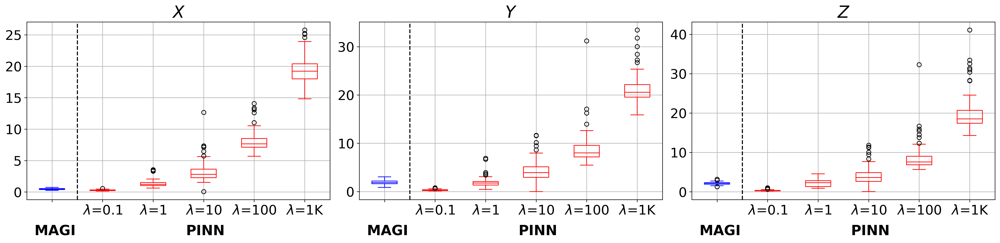

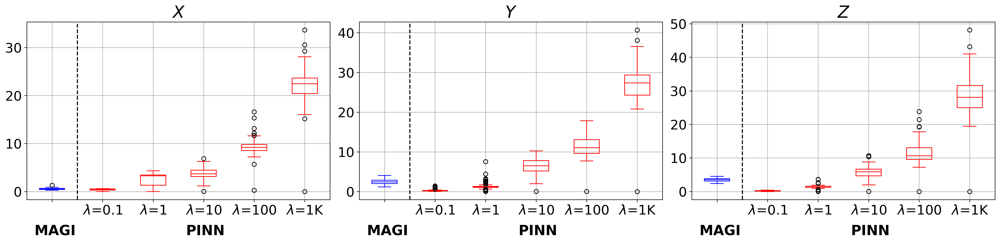

In [4]:
# hot-access letters
a, b, r, s = "a", "b", "r", "s"

# separate box plots for each regime + dobs (parameter inference)
for rho in [23.0, 28.0]:
    for dobs in [10]:
        for alpha in [0.05]:
        
            # restrict our query
            restricted = physics_logs.query(f"rho == {rho} and dobs == {dobs} and alpha == {alpha}")

            # 1 x 3 grid of subplots (X, Y, Z)
            fig, ax = plt.subplots(1, 3, dpi=300, figsize=(20, 5))
            
            # go thru each component
            for i, var in enumerate(["X", "Y", "Z"]):
                
                # grid it up
                ax[i].grid()
                
                # MAGI physics residuals (absolute error)
                ax[i].boxplot(x=np.abs(restricted.query("model == 'magi'")[f"{var}_pRMSE"]), 
                              positions=[0], boxprops={"color" : "blue"}, whiskerprops={"color" : "blue"}, 
                              capprops={"color" : "blue"}, medianprops={"color" : "blue"}, widths=0.5)
                
                # go thru PINN
                for j, lmbda in enumerate([0.1, 1.0, 10.0, 100.0, 1000.0]):
                    ax[i].boxplot(x=np.abs(restricted.query(f"lmbda == {lmbda}")[f"{var}_pRMSE"]),
                                  positions=[j+1], boxprops={"color" : "red"}, whiskerprops={"color" : "red"}, 
                                  capprops={"color" : "red"}, medianprops={"color" : "red"}, widths=0.5)
                
                # beautify
                ax[i].set_title(f"${var}$", fontsize=24)
                ax[i].set_xticklabels(["", 
                                       "$\lambda$=0.1", 
                                       "$\lambda$=1", 
                                       "$\lambda$=10", 
                                       "$\lambda$=100", 
                                       "$\lambda$=1K"])
                ax[i].tick_params("both", labelsize=19)
                ax[i].axvline(x=0.5, color="black", linestyle="--")
                ax[i].annotate("PINN", xy=(0.525, -0.2), 
                               xycoords="axes fraction", fontsize=20, weight="bold")
                ax[i].annotate("MAGI", xy=(0.025, -0.2), 
                               xycoords="axes fraction", fontsize=20, weight="bold")
            
            # overall beautifying
            regime_desc = "Lorenz (Stable, Transient Chaos)" if rho == 23.0 else "Lorenz (Chaotic, Butterfly)"
            plt.tight_layout()
            plt.savefig(f"camera_ready/boxplots/phys-resids_rho={rho}_dobs={dobs}_alpha={alpha}.jpg", 
                        facecolor="white", bbox_inches="tight")
            plt.show()

# $6 \times 3$ Figure Panels

## 1. In-Sample Inferred Trajectories

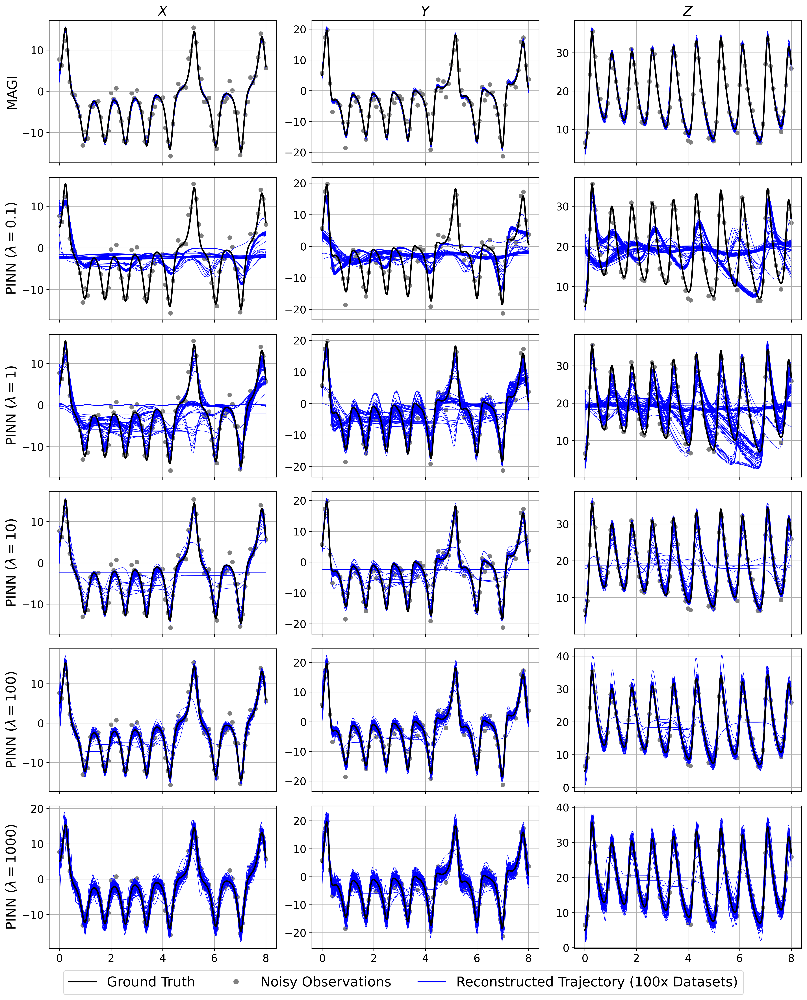

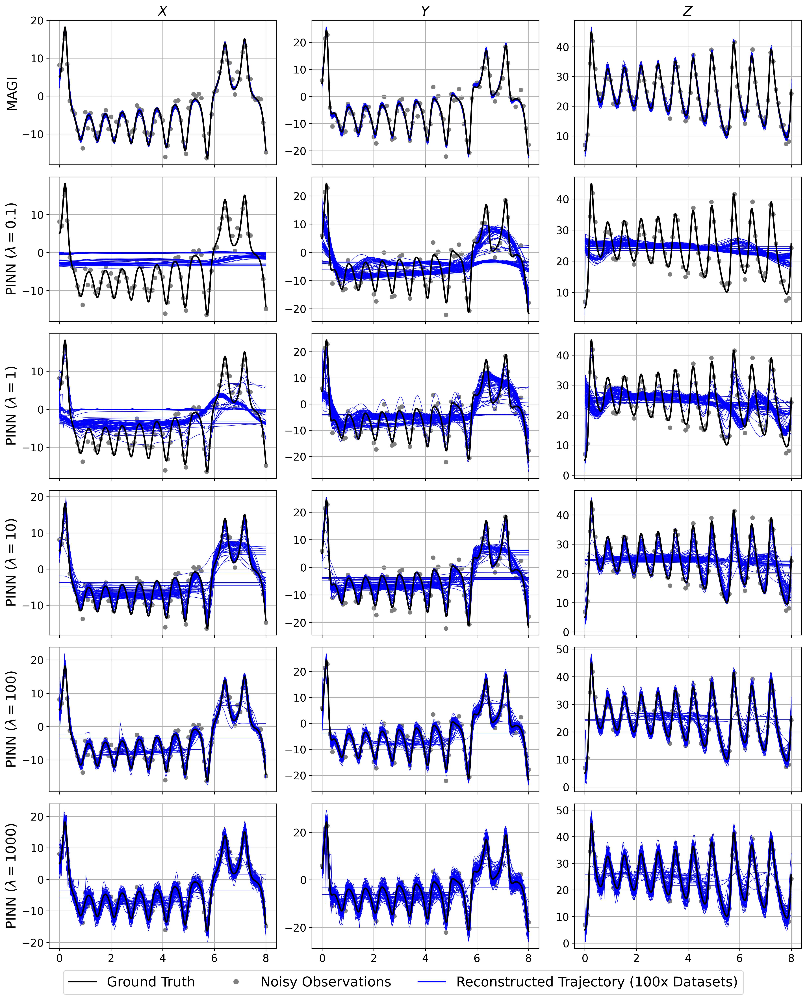

In [5]:
# fixed settings
t_max = 8.0

# separate figure panels
for rho in [23.0, 28.0]:
    for dobs in [10]:
        
        # get the discretization
        discret = int(np.log2(40 // dobs))
        
        for alpha in [0.05]:
            
            # create our 6 x 3 grid of subplots
            fig, ax = plt.subplots(6, 3, dpi=300, figsize=(15, 18), sharex=True)
            
            # let's use ground truth + noisy observations from seed=0
            truth = pd.read_csv(f"data/LORENZ_rho={rho}_alpha={alpha}_seed=0.csv").query(f"t <= {t_max}")
            noisy_data = truth.iloc[::int((truth.index.shape[0] - 1) / (dobs * t_max))]
            
            #### MAGI ####
            
            # create a list to store our to-be-meaned predictions for MAGI
            mean_preds = []
            
            # start with MAGI - plot all the runs as thin blue tendrils, highlighter the mean
            for seed in range(100):
                
                # get the .pickle for this seed
                fname = f"results/magi/rho={rho}_alpha={alpha}_dobs={dobs}_discret={discret}_seed={seed}.pickle"
                with open(fname, "rb") as file:
                    results = pickle.load(file)
                ts = results["I"].flatten()
                preds = results["X_samps"].mean(axis=0)
                mean_preds.append(preds)
                
                # if we're on the last seed, compute the mean prediction
                if seed == 99:
                    mean_preds = np.array(mean_preds).mean(axis=0)
                
                # go thru each variable
                for j, var in enumerate(["X", "Y", "Z"]):
                    
                    # if this is the first seed, let's scatter the obs + show the truth, also grid
                    if seed == 0:
                        
                        # make sure we mark MAGI
                        if j == 0:
                            ax[0, j].set_ylabel("MAGI", fontsize=18)
                        
                        # scatter the noisy observations + do tickparams (YES GRIDDING!)
                        ax[0, j].grid()
                        ax[0, j].set_title(f"${var}$", fontsize=18)
                        ax[0, j].tick_params("both", labelsize=14)
                    
                    # always plot the thin tendrils where they belong
                    ax[0, j].plot(ts, preds[:,j], color="blue", linewidth=0.5, alpha=1.0)
                
                    # if it's the last one, plot the ground truth + noisy data
                    if seed == 99:
                        ax[0, j].plot(truth["t"], truth[f"{var}_true"], color="black", linewidth=2.0, linestyle="--")
                        ax[0, j].scatter(noisy_data["t"], noisy_data[f"{var}_obs"], s=25, color="grey")
                        
            #### PINN ####
            
            # iterate through all of our lmbda values
            for i, lmbda in enumerate([0.1, 1.0, 10.0, 100.0, 1000.0]):
                
                # create a list to store our to-be-meaned predictions for PINN with this lmbda
                mean_preds = []

                # for PINN - plot all the runs as thin red tendrils, highlighter the mean
                for seed in range(100):

                    # load in the predictions + add to our mean predictions
                    preds = pd.read_csv(f"results/pinn/lmbda={lmbda}_rho={rho}_alpha={alpha}_dobs={dobs}_seed={seed}/oos_preds.csv")
                    ts = preds["t"].values
                    preds = preds[["X", "Y", "Z"]].values
                    mean_preds.append(preds)

                    # if we're on the last seed, compute the mean prediction
                    if seed == 99:
                        mean_preds = np.array(mean_preds).mean(axis=0)

                    # go thru each variable
                    for j, var in enumerate(["X", "Y", "Z"]):

                        # if this is the first seed, let's scatter the obs + show the truth, also grid
                        if seed == 0:

                            # make sure we mark MAGI
                            if j == 0:
                                lmbda_fmt = int(lmbda) if lmbda >= 1.0 else lmbda
                                ax[i+1, j].set_ylabel(f"PINN ($\lambda = {lmbda_fmt}$)", fontsize=18)

                            # scatter the noisy observations + do tickparams (YES GRIDDING!)
                            ax[i+1, j].grid()
                            ax[i+1, j].tick_params("both", labelsize=14)

                        # always plot the thin tendrils where they belong
                        ax[i+1, j].plot(ts, preds[:,j], color="blue", linewidth=0.5, alpha=1.0)

                        # if it's the last one, plot the ground truth + noisy obs.
                        if seed == 99:
                            ax[i+1, j].plot(truth["t"], truth[f"{var}_true"], color="black", linewidth=2.0, linestyle="--")
                            ax[i+1, j].scatter(noisy_data["t"], noisy_data[f"{var}_obs"], s=25, color="grey")
            
            #### beautifying at the very end ####
            
            regime_desc = "Lorenz (Stable, Transient Chaos)" if rho == 23.0 else "Lorenz (Chaotic, Butterfly)"
            custom_lines = [
                Line2D([0], [0], color="black", linewidth=2.0, alpha=1.0, linestyle="--", label="Ground Truth"),
                Line2D([0], [0], color="grey", marker="o", linestyle="None", label="Noisy Observations"),
                Line2D([0], [0], color="blue", linewidth=2.0, alpha=1.0, label="Reconstructed Trajectory (100x Datasets)"),
            ]
            fig.legend(handles=custom_lines, loc="lower center", ncol=3, fontsize=18, bbox_to_anchor=(0.5, -0.03))
            plt.tight_layout()
            plt.savefig(f"camera_ready/trajectories/in-sample_rho={rho}_dobs={dobs}_alpha={alpha}.jpg", 
                        facecolor="white", bbox_inches="tight")
            plt.show()

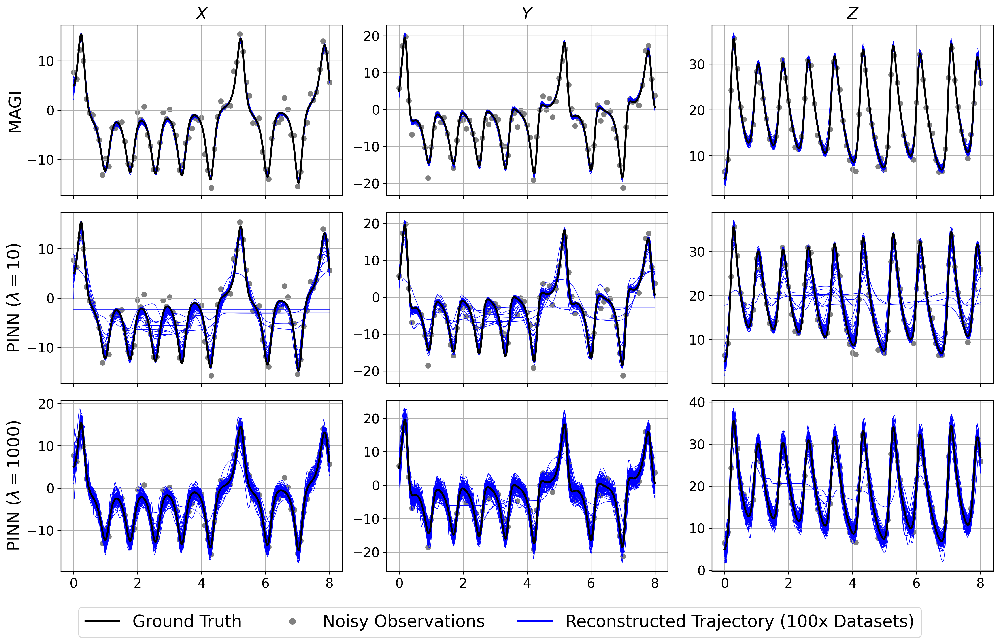

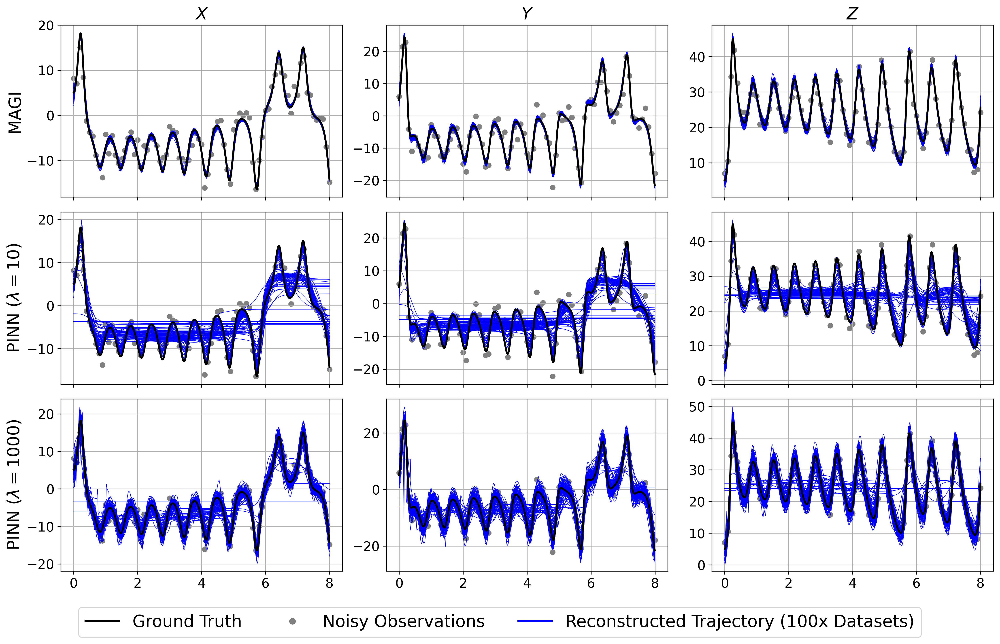

In [6]:
#### TRUNCATED VERSIONS - ONLY DO MAGI, 10.0, 1000.0
a, b, r, s = "a", "b", "r", "s"

# fixed settings
t_max = 8.0

# separate figure panels
for rho in [23.0, 28.0]:
    for dobs in [10]:
        
        # get the discretization
        discret = int(np.log2(40 // dobs))
        
        for alpha in [0.05]:
            
            # create our 6 x 3 grid of subplots
            fig, ax = plt.subplots(3, 3, dpi=300, figsize=(15, 9), sharex=True)
            
            # let's use ground truth + noisy observations from seed=0
            truth = pd.read_csv(f"data/LORENZ_rho={rho}_alpha={alpha}_seed=0.csv").query(f"t <= {t_max}")
            noisy_data = truth.iloc[::int((truth.index.shape[0] - 1) / (dobs * t_max))]
            
            #### MAGI ####
            
            # create a list to store our to-be-meaned predictions for MAGI
            mean_preds = []
            
            # start with MAGI - plot all the runs as thin blue tendrils, highlighter the mean
            for seed in range(100):
                
                # get the .pickle for this seed
                fname = f"results/magi/rho={rho}_alpha={alpha}_dobs={dobs}_discret={discret}_seed={seed}.pickle"
                with open(fname, "rb") as file:
                    results = pickle.load(file)
                ts = results["I"].flatten()
                preds = results["X_samps"].mean(axis=0)
                mean_preds.append(preds)
                
                # if we're on the last seed, compute the mean prediction
                if seed == 99:
                    mean_preds = np.array(mean_preds).mean(axis=0)
                
                # go thru each variable
                for j, var in enumerate(["X", "Y", "Z"]):
                    
                    # if this is the first seed, let's scatter the obs + show the truth, also grid
                    if seed == 0:
                        
                        # make sure we mark MAGI
                        if j == 0:
                            ax[0, j].set_ylabel("MAGI", fontsize=18)
                        
                        # scatter the noisy observations + do tickparams (YES GRIDDING!)
                        ax[0, j].grid()
                        ax[0, j].set_title(f"${var}$", fontsize=18)
                        ax[0, j].tick_params("both", labelsize=14)
                    
                    # always plot the thin tendrils where they belong
                    ax[0, j].plot(ts, preds[:,j], color="blue", linewidth=0.5, alpha=1.0)
                
                    # if it's the last one, plot the ground truth + noisy obs.
                    if seed == 99:
                        ax[0, j].plot(truth["t"], truth[f"{var}_true"], color="black", linewidth=2.0, linestyle="--")
                        ax[0, j].scatter(noisy_data["t"], noisy_data[f"{var}_obs"], s=25, color="grey")
                        
            #### PINN ####
            
            # iterate through all of our lmbda values
            for i, lmbda in enumerate([10.0, 1000.0]):
                
                # create a list to store our to-be-meaned predictions for PINN with this lmbda
                mean_preds = []

                # for PINN - plot all the runs as thin red tendrils, highlighter the mean
                for seed in range(100):

                    # load in the predictions + add to our mean predictions
                    preds = pd.read_csv(f"results/pinn/lmbda={lmbda}_rho={rho}_alpha={alpha}_dobs={dobs}_seed={seed}/oos_preds.csv")
                    ts = preds["t"].values
                    preds = preds[["X", "Y", "Z"]].values
                    mean_preds.append(preds)

                    # if we're on the last seed, compute the mean prediction
                    if seed == 99:
                        mean_preds = np.array(mean_preds).mean(axis=0)

                    # go thru each variable
                    for j, var in enumerate(["X", "Y", "Z"]):

                        # if this is the first seed, let's scatter the obs + show the truth, also grid
                        if seed == 0:

                            # make sure we mark MAGI
                            if j == 0:
                                lmbda_fmt = int(lmbda) if lmbda >= 1.0 else lmbda
                                ax[i+1, j].set_ylabel(f"PINN ($\lambda = {lmbda_fmt}$)", fontsize=18)

                            # scatter the noisy observations + do tickparams (YES GRIDDING!)
                            ax[i+1, j].grid()
                            ax[i+1, j].tick_params("both", labelsize=14)

                        # always plot the thin tendrils where they belong
                        ax[i+1, j].plot(ts, preds[:,j], color="blue", linewidth=0.5, alpha=1.0)

                        # if it's the last one, plot the ground truth + noisy obs.
                        if seed == 99:
                            ax[i+1, j].plot(truth["t"], truth[f"{var}_true"], color="black", linewidth=2.0, linestyle="--")
                            ax[i+1, j].scatter(noisy_data["t"], noisy_data[f"{var}_obs"], s=25, color="grey")
            
            #### beautifying at the very end ####
            
            regime_desc = "Lorenz (Stable, Transient Chaos)" if rho == 23.0 else "Lorenz (Chaotic, Butterfly)"
            custom_lines = [
                Line2D([0], [0], color="black", linewidth=2.0, alpha=1.0, label="Ground Truth", linestyle="--"),
                Line2D([0], [0], color="grey", marker="o", linestyle="None", label="Noisy Observations"),
                Line2D([0], [0], color="blue", linewidth=2.0, alpha=1.0, label="Reconstructed Trajectory (100x Datasets)"),
            ]
            fig.legend(handles=custom_lines, loc="lower center", ncol=3, fontsize=18, bbox_to_anchor=(0.5, -0.075))
            plt.tight_layout()
            plt.savefig(f"camera_ready/trajectories/TRUNCATED_in-sample_rho={rho}_dobs={dobs}_alpha={alpha}.jpg", 
                        facecolor="white", bbox_inches="tight")
            plt.show()

## 2. Forecasting Inferred Trajectories

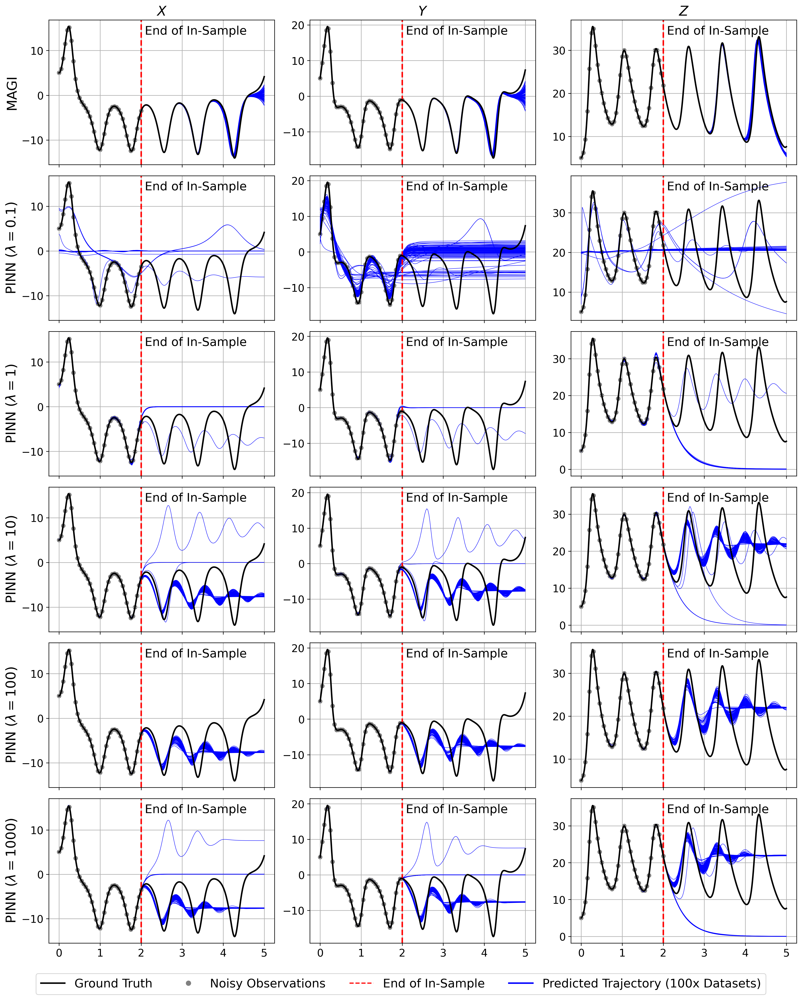

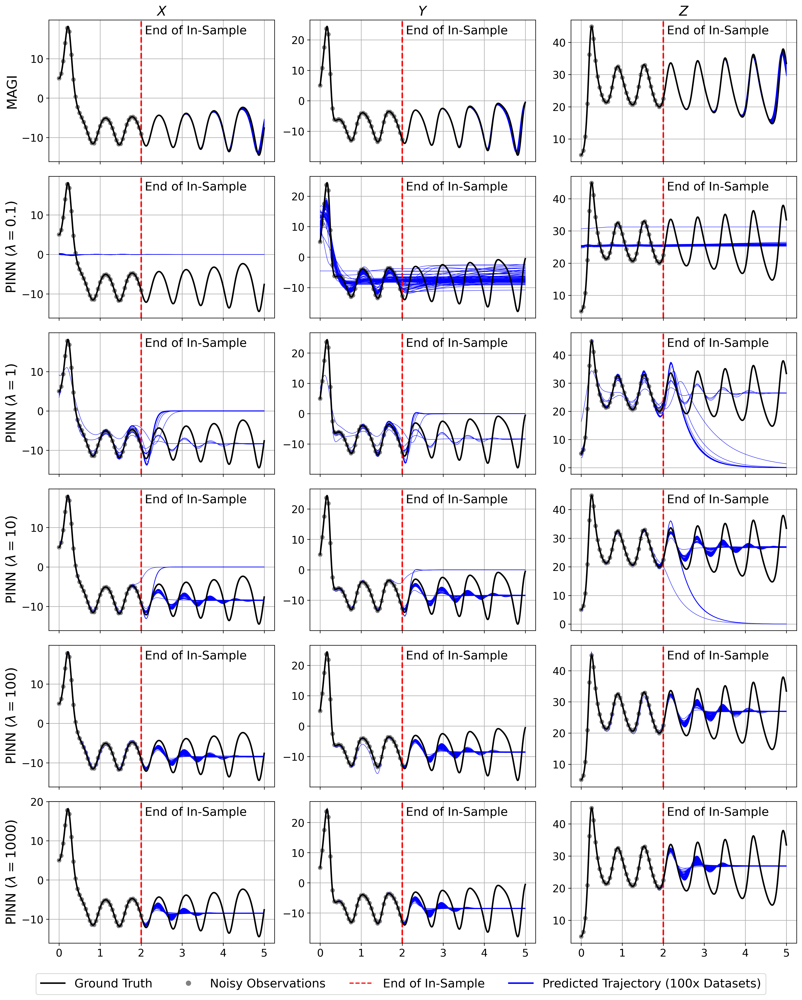

In [7]:
# fixed settings
t_max, t_max_pred = 2.0, 5.0
dobs, alpha = 20, 0.0005
discret = int(np.log2(40 // dobs))

# separate figure panels
for rho in [23.0, 28.0]:
            
    # create our 6 x 3 grid of subplots
    fig, ax = plt.subplots(6, 3, dpi=300, figsize=(15, 18), sharex=True)

    # let's use ground truth + noisy observations from seed=0
    truth = pd.read_csv(f"data/LORENZ_rho={rho}_alpha={alpha}_seed=0.csv").query(f"t <= {t_max_pred}")
    noisy_data = truth.query(f"t <= {t_max}")
    noisy_data = noisy_data.iloc[::int((noisy_data.index.shape[0] - 1) / (dobs * t_max))]

    #### MAGI ####

    # create a list to store our to-be-meaned predictions for MAGI
    mean_preds = []

    # start with MAGI - plot all the runs as thin blue tendrils, highlighter the mean
    for seed in range(100):

        # get the .pickle for this seed
        fname = f"results/magi_forecasting/rho={rho}_alpha={alpha}_dobs={dobs}_discret={discret}_seed={seed}.pickle"
        with open(fname, "rb") as file:
            results = pickle.load(file)
        ts = results[3]["I"].flatten()
        preds = results[3]["X_samps"].mean(axis=0)
        mean_preds.append(preds)

        # if we're on the last seed, compute the mean prediction
        if seed == 99:
            mean_preds = np.array(mean_preds).mean(axis=0)

        # go thru each variable
        for j, var in enumerate(["X", "Y", "Z"]):

            # if this is the first seed, let's scatter the obs + show the truth, also grid
            if seed == 0:

                # make sure we mark MAGI
                if j == 0:
                    ax[0, j].set_ylabel("MAGI", fontsize=18)

                # scatter the noisy observations + do tickparams (YES GRIDDING!)
                ax[0, j].set_title(f"${var}$", fontsize=18)
                ax[0, j].tick_params("both", labelsize=14)
                ax[0, j].grid()

            # always plot the thin tendrils where they belong
            ax[0, j].plot(ts, preds[:,j], color="blue", linewidth=0.5, alpha=1.0)

            # if it's the last one, plot the ground truth + noisy obs.
            if seed == 99:
                ax[0, j].axvline(x=t_max, linestyle="--", linewidth=2.0, color="red")
                ax[0, j].plot(truth["t"], truth[f"{var}_true"], color="black", linewidth=2.0, linestyle="--")
                ax[0, j].scatter(noisy_data["t"], noisy_data[f"{var}_obs"], s=25, color="grey")
                ax[0, j].annotate(
                    "End of In-Sample", 
                    xy=(0.425, 0.9), 
                    xycoords="axes fraction", 
                    fontsize=16
                )

    #### PINN ####

    # iterate through all of our lmbda values
    for i, lmbda in enumerate([0.1, 1.0, 10.0, 100.0, 1000.0]):

        # create a list to store our to-be-meaned predictions for PINN with this lmbda
        mean_preds = []

        # for PINN - plot all the runs as thin red tendrils, highlighter the mean
        for seed in range(100):

            # load in the predictions + add to our mean predictions
            preds = pd.read_csv(f"results/pinn_forecasting/lmbda={lmbda}_rho={rho}_alpha={alpha}_dobs={dobs}_seed={seed}/oos_preds.csv")\
            .query(f"t <= {t_max_pred}")
            ts = preds["t"].values
            preds = preds[["X", "Y", "Z"]].values
            mean_preds.append(preds)

            # if we're on the last seed, compute the mean prediction
            if seed == 99:
                mean_preds = np.array(mean_preds).mean(axis=0)

            # go thru each variable
            for j, var in enumerate(["X", "Y", "Z"]):

                # if this is the first seed, let's scatter the obs + show the truth, also grid
                if seed == 0:

                    # make sure we mark PINN
                    if j == 0:
                        lmbda_fmt = int(lmbda) if lmbda >= 1.0 else lmbda
                        ax[i+1, j].set_ylabel(f"PINN ($\lambda = {lmbda_fmt}$)", fontsize=18)

                    # gridding + truth
                    ax[i+1, j].tick_params("both", labelsize=14)
                    ax[i+1, j].grid()

                # always plot the thin tendrils where they belong
                ax[i+1, j].plot(ts, preds[:,j], color="blue", linewidth=0.5, alpha=1.0)

                # if it's the last one, plot the ground truth + noisy obs.
                if seed == 99:
                    ax[i+1, j].axvline(x=t_max, linestyle="--", linewidth=2.0, color="red")
                    ax[i+1, j].plot(truth["t"], truth[f"{var}_true"], color="black", linewidth=2.0, linestyle="--")
                    ax[i+1, j].scatter(noisy_data["t"], noisy_data[f"{var}_obs"], s=25, color="grey")
                    ax[i+1, j].annotate(
                        "End of In-Sample", 
                        xy=(0.425, 0.9), 
                        xycoords="axes fraction", 
                        fontsize=16
                    )

    #### beautifying at the very end ####

    custom_lines = [
        Line2D([0], [0], color="black", linewidth=2.0, alpha=1.0, linestyle="--", label="Ground Truth"),
        Line2D([0], [0], color="grey", marker="o", linestyle="None", label="Noisy Observations"),
        Line2D([0], [0], color="red", linestyle="--", label="End of In-Sample"),
        Line2D([0], [0], color="blue", linewidth=2.0, alpha=1.0, label="Predicted Trajectory (100x Datasets)"),
    ]
    fig.legend(handles=custom_lines, loc="lower center", ncol=4, fontsize=16, bbox_to_anchor=(0.5, -0.035))
    plt.tight_layout()
    plt.savefig(f"camera_ready/trajectories/forecasting_rho={rho}_dobs={dobs}_alpha={alpha}.jpg", 
                facecolor="white", bbox_inches="tight")

    plt.show()

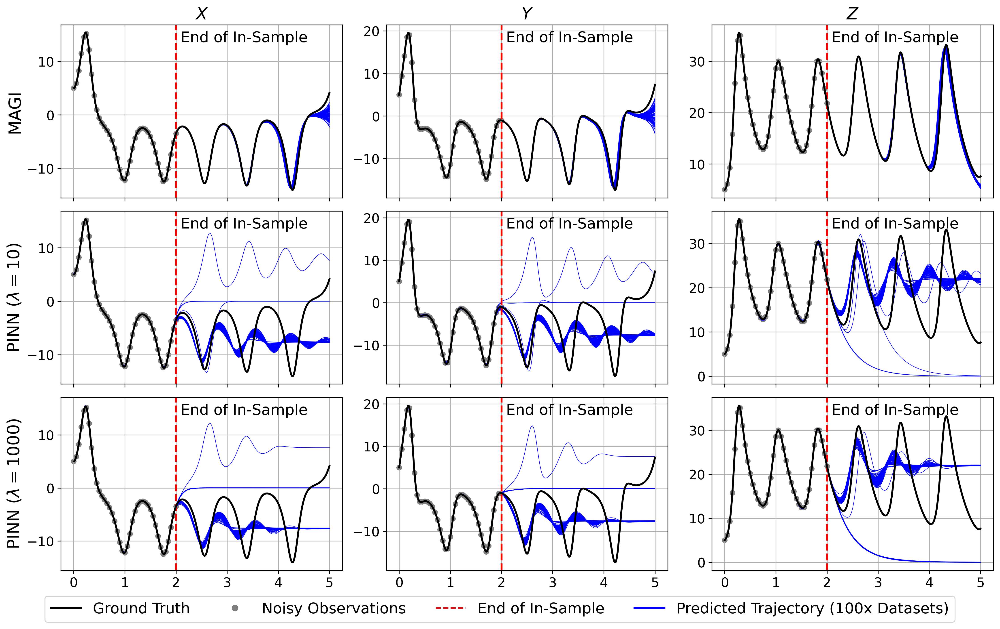

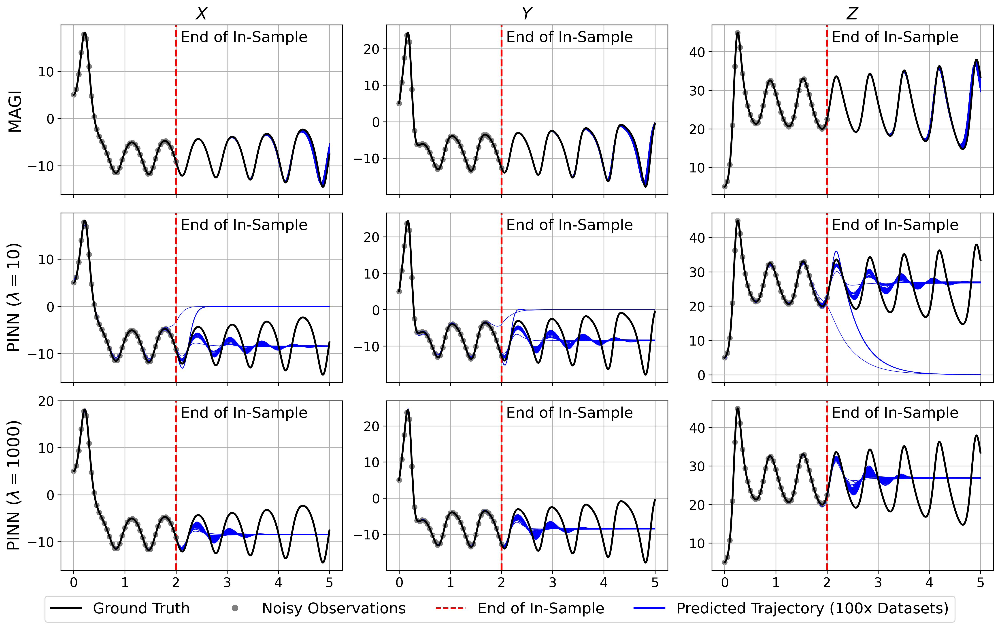

In [8]:
#### TRUNCATED VERSIONS - ONLY DO MAGI, 10.0, 1000.0
a, b, r, s = "a", "b", "r", "s"

# fixed settings
t_max, t_max_pred = 2.0, 5.0
dobs, alpha = 20, 0.0005
discret = int(np.log2(40 // dobs))

# separate figure panels
for rho in [23.0, 28.0]:
            
    # create our 6 x 3 grid of subplots
    fig, ax = plt.subplots(3, 3, dpi=300, figsize=(15, 9), sharex=True)

    # let's use ground truth + noisy observations from seed=0
    truth = pd.read_csv(f"data/LORENZ_rho={rho}_alpha={alpha}_seed=0.csv").query(f"t <= {t_max_pred}")
    noisy_data = truth.query(f"t <= {t_max}")
    noisy_data = noisy_data.iloc[::int((noisy_data.index.shape[0] - 1) / (dobs * t_max))]

    #### MAGI ####

    # create a list to store our to-be-meaned predictions for MAGI
    mean_preds = []

    # start with MAGI - plot all the runs as thin blue tendrils, highlighter the mean
    for seed in range(100):

        # get the .pickle for this seed
        fname = f"results/magi_forecasting/rho={rho}_alpha={alpha}_dobs={dobs}_discret={discret}_seed={seed}.pickle"
        with open(fname, "rb") as file:
            results = pickle.load(file)
        ts = results[3]["I"].flatten()
        preds = results[3]["X_samps"].mean(axis=0)
        mean_preds.append(preds)

        # if we're on the last seed, compute the mean prediction
        if seed == 99:
            mean_preds = np.array(mean_preds).mean(axis=0)

        # go thru each variable
        for j, var in enumerate(["X", "Y", "Z"]):

            # if this is the first seed, let's scatter the obs + show the truth, also grid
            if seed == 0:

                # make sure we mark MAGI
                if j == 0:
                    ax[0, j].set_ylabel("MAGI", fontsize=18)

                # scatter the noisy observations + do tickparams (YES GRIDDING!)
                ax[0, j].set_title(f"${var}$", fontsize=18)
                ax[0, j].tick_params("both", labelsize=14)
                ax[0, j].grid()

            # always plot the thin tendrils where they belong
            ax[0, j].plot(ts, preds[:,j], color="blue", linewidth=0.5, alpha=1.0)

            # if it's the last one, plot the ground truth + noisy obs., add in end of in-sample
            if seed == 99:
                ax[0, j].axvline(x=t_max, linestyle="--", linewidth=2.0, color="red")
                ax[0, j].plot(truth["t"], truth[f"{var}_true"], color="black", linewidth=2.0, linestyle="--")
                ax[0, j].scatter(noisy_data["t"], noisy_data[f"{var}_obs"], s=25, color="grey")
                ax[0, j].annotate(
                    "End of In-Sample", 
                    xy=(0.425, 0.9), 
                    xycoords="axes fraction", 
                    fontsize=16
                )

    #### PINN ####

    # iterate through all of our lmbda values
    for i, lmbda in enumerate([10.0, 1000.0]):

        # create a list to store our to-be-meaned predictions for PINN with this lmbda
        mean_preds = []

        # for PINN - plot all the runs as thin red tendrils, highlighter the mean
        for seed in range(100):

            # load in the predictions + add to our mean predictions
            preds = pd.read_csv(f"results/pinn_forecasting/lmbda={lmbda}_rho={rho}_alpha={alpha}_dobs={dobs}_seed={seed}/oos_preds.csv")\
            .query(f"t <= {t_max_pred}")
            ts = preds["t"].values
            preds = preds[["X", "Y", "Z"]].values
            mean_preds.append(preds)

            # if we're on the last seed, compute the mean prediction
            if seed == 99:
                mean_preds = np.array(mean_preds).mean(axis=0)

            # go thru each variable
            for j, var in enumerate(["X", "Y", "Z"]):

                # if this is the first seed, let's scatter the obs + show the truth, also grid
                if seed == 0:

                    # make sure we mark PINN
                    if j == 0:
                        lmbda_fmt = int(lmbda) if lmbda >= 1.0 else lmbda
                        ax[i+1, j].set_ylabel(f"PINN ($\lambda = {lmbda_fmt}$)", fontsize=18)

                    # gridding + truth
                    ax[i+1, j].tick_params("both", labelsize=14)
                    ax[i+1, j].grid()

                # always plot the thin tendrils where they belong
                ax[i+1, j].plot(ts, preds[:,j], color="blue", linewidth=0.5, alpha=1.0)

                # if it's the last one, plot the ground truth, noisy obs, mark end of in-sample
                if seed == 99:
                    ax[i+1, j].axvline(x=t_max, linestyle="--", linewidth=2.0, color="red")
                    ax[i+1, j].plot(truth["t"], truth[f"{var}_true"], color="black", linewidth=2.0, linestyle="--")
                    ax[i+1, j].scatter(noisy_data["t"], noisy_data[f"{var}_obs"], s=25, color="grey")
                    ax[i+1, j].annotate(
                        "End of In-Sample", 
                        xy=(0.425, 0.9), 
                        xycoords="axes fraction", 
                        fontsize=16
                    )

    #### beautifying at the very end ####

    custom_lines = [
        Line2D([0], [0], color="black", linewidth=2.0, alpha=1.0, label="Ground Truth"),
        Line2D([0], [0], color="grey", marker="o", linestyle="None", label="Noisy Observations"),
        Line2D([0], [0], color="red", linestyle="--", label="End of In-Sample"),
        Line2D([0], [0], color="blue", linewidth=2.0, alpha=1.0, label="Predicted Trajectory (100x Datasets)"),
    ]
    fig.legend(handles=custom_lines, loc="lower center", ncol=4, fontsize=16, bbox_to_anchor=(0.5, -0.05))
    plt.tight_layout()
    plt.savefig(f"camera_ready/trajectories/TRUNCATED_forecasting_rho={rho}_dobs={dobs}_alpha={alpha}.jpg", 
                facecolor="white", bbox_inches="tight")

    plt.show()